# Imports

In [ ]:
import cv2
import torch
import numpy as np
from torch import nn
from tqdm import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import random_split
from scipy.ndimage import binary_opening, binary_closing

# Model

In [ ]:
class CNNBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.net(x)


class MetalSurface(nn.Module):
    def __init__(self, in_ch=3, base=32, num_classes=1):
        super().__init__()

        self.c1_1 = CNNBlock(in_ch, base)
        self.c1_2 = CNNBlock(base, base*2)
        self.c1_3 = CNNBlock(base*2, base*4)
        self.c1_4 = CNNBlock(base*4, base*8)
        self.c1_5 = CNNBlock(base*8, base)
        self.heat_conv = nn.Conv2d(base, 1, kernel_size=1)

    def forward(self, x):
        f = self.c1_1(x); f = self.c1_2(f); f = self.c1_3(f); f = self.c1_4(f); f = self.c1_5(f)

        heat = self.heat_conv(f)
        heat = F.interpolate(heat, size=x.shape[-2:], mode='bilinear', align_corners=False)

        return heat


# Loss Function

In [ ]:
def metal_surface_loss():
    def loss_function(predicted, true):
        loss = F.binary_cross_entropy_with_logits(predicted, true, reduction="mean")
        return loss
    return loss_function

# Dataset

In [4]:
dataset = torch.load("datasets/grabbability_dataset_rgb_onehot_bce.pt")

class TupleDataset(Dataset):
    def __init__(self, data):
        self.data = data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx]

N = len(dataset)
train_size = int(0.8 * N)
test_size = N - train_size

train_dataset, test_dataset = random_split(
    dataset,
    [train_size, test_size]
)

train_loader = DataLoader(
    TupleDataset(train_dataset),
    batch_size=5,
    shuffle=True,
    pin_memory=True
)

test_loader = DataLoader(
    TupleDataset(test_dataset),
    batch_size=5,
    shuffle=True,
    pin_memory=True
)

C:\Users\agile\AppData\Local\Temp\ipykernel_22876\693260698.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  dataset = torch.load("datasets/grabbability_dataset_rgb_oneho

# Visualize Dataset

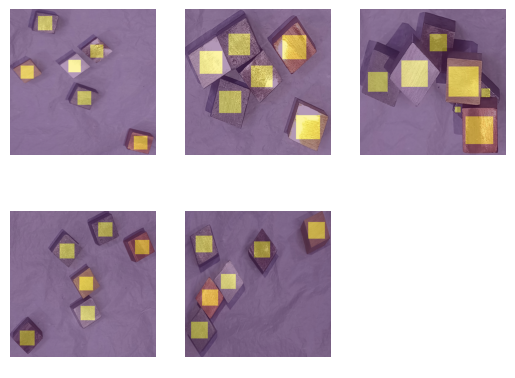

In [5]:
def visualize_dataset(images, labels):
    B = images.size(0)

    fig, axes = plt.subplots(B // 2, B - (B // 2))
    axes = axes.flatten()

    for ax in axes:
        ax.axis("off")
    
    for i in range(B):
        image = images[i].detach().cpu().numpy() # (3, H, W)
        label = labels[i].detach().cpu().numpy() # (H, W)

        if image.max() <= 1.0:
            image = (image * 255).astype(np.uint8)

        image = np.transpose(image, (1, 2, 0)) # (H, W, 3)
        label = np.transpose(label, (1, 2, 0))
        
        axes[i].imshow(image)
        axes[i].imshow(label, cmap="viridis", alpha=0.4)

    plt.show()
    
images, labels = next(iter(train_loader))
visualize_dataset(images, labels)

# Training

In [ ]:
device = 'cuda'
model = MetalSurface()
model.to(device)

MetalEdge(
  (c1_1): CNNBlock(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (c1_2): CNNBlock(
    (net): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (c1_3): CNNBlock(
    (net): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), st

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5)
criterion = metal_surface_loss()

# training parameters
num_epochs = 100

Epoch 1/100: 100%|██████████| 16/16 [00:32<00:00,  2.00s/it]


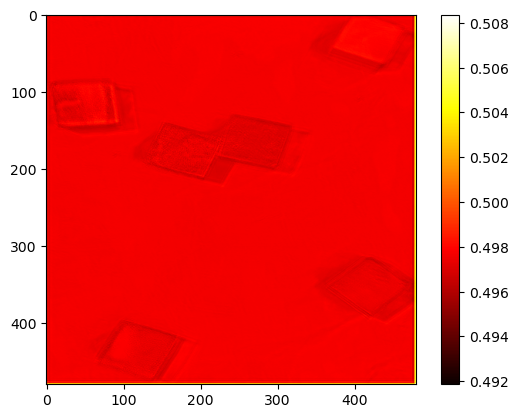

Epoch 1: Train Loss = 0.127847
Epoch 1: Val Loss = 0.034310


Epoch 2/100: 100%|██████████| 16/16 [00:34<00:00,  2.16s/it]


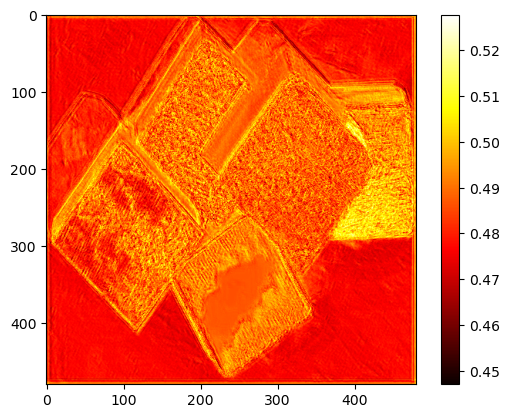

Epoch 2: Train Loss = 0.076755
Epoch 2: Val Loss = 0.042851


Epoch 3/100: 100%|██████████| 16/16 [00:34<00:00,  2.18s/it]


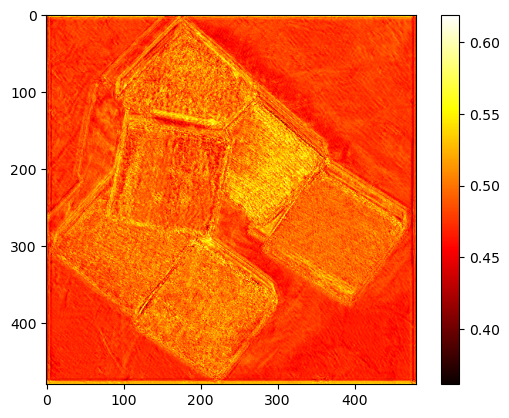

Epoch 3: Train Loss = 0.055513
Epoch 3: Val Loss = 0.042752


Epoch 4/100: 100%|██████████| 16/16 [00:32<00:00,  2.06s/it]


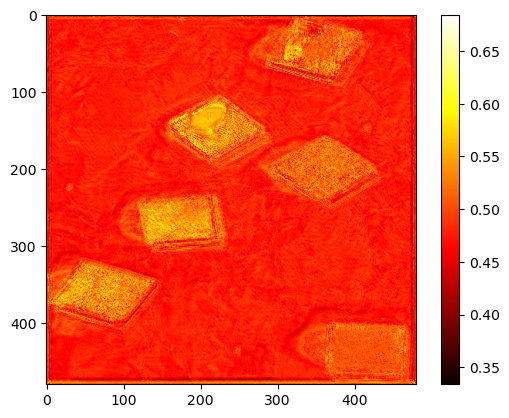

Epoch 4: Train Loss = 0.044055
Epoch 4: Val Loss = 0.036464


Epoch 5/100: 100%|██████████| 16/16 [00:33<00:00,  2.07s/it]


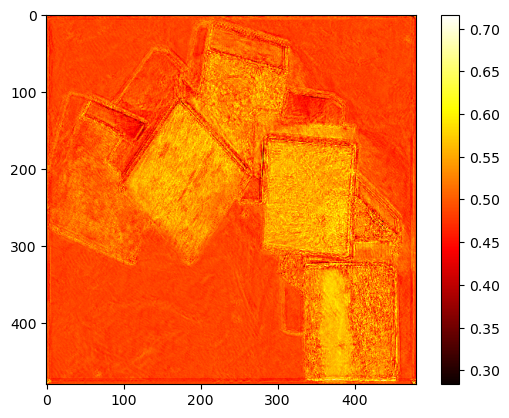

Epoch 5: Train Loss = 0.037646
Epoch 5: Val Loss = 0.033444


Epoch 6/100: 100%|██████████| 16/16 [00:33<00:00,  2.08s/it]


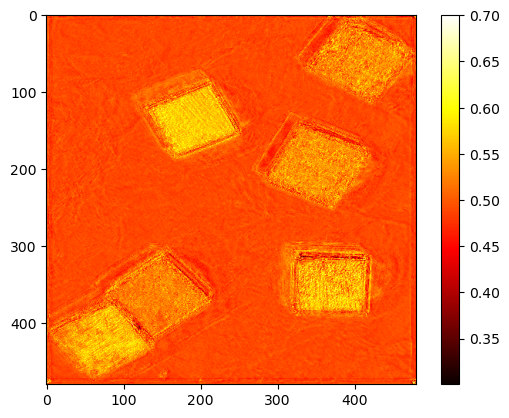

Epoch 6: Train Loss = 0.034410
Epoch 6: Val Loss = 0.031046


Epoch 7/100: 100%|██████████| 16/16 [00:33<00:00,  2.12s/it]


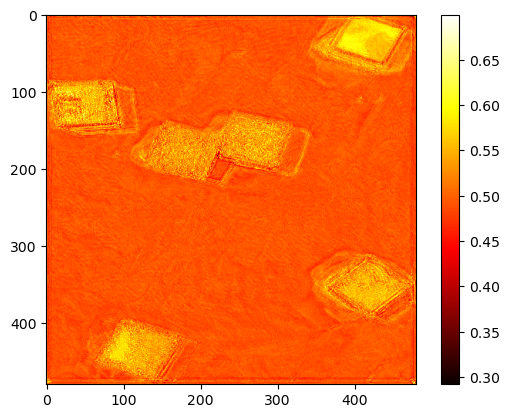

Epoch 7: Train Loss = 0.031909
Epoch 7: Val Loss = 0.028785


Epoch 8/100: 100%|██████████| 16/16 [00:34<00:00,  2.18s/it]


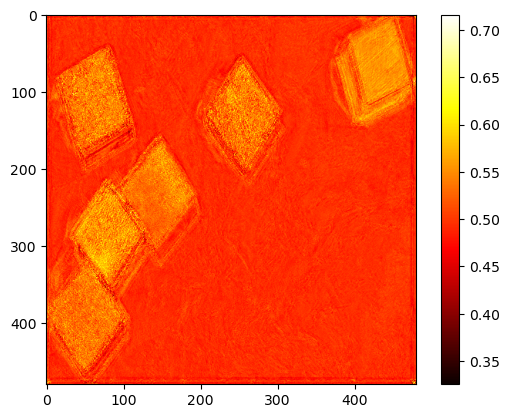

Epoch 8: Train Loss = 0.030323
Epoch 8: Val Loss = 0.027504


Epoch 9/100: 100%|██████████| 16/16 [00:34<00:00,  2.13s/it]


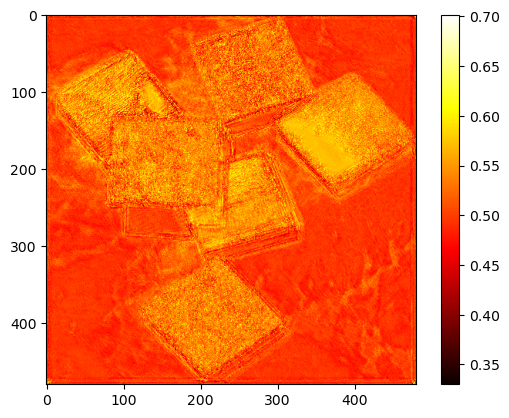

Epoch 9: Train Loss = 0.029066
Epoch 9: Val Loss = 0.026557


Epoch 10/100: 100%|██████████| 16/16 [00:33<00:00,  2.08s/it]


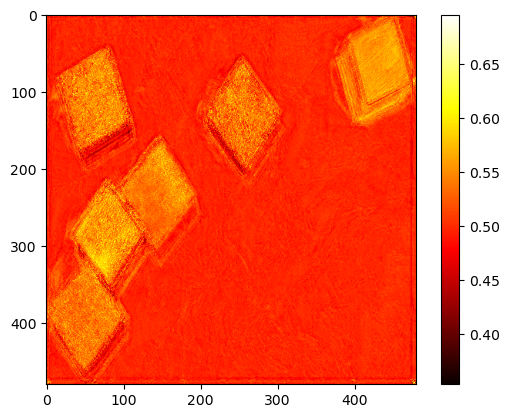

Epoch 10: Train Loss = 0.028397
Epoch 10: Val Loss = 0.025956


Epoch 11/100: 100%|██████████| 16/16 [00:36<00:00,  2.28s/it]


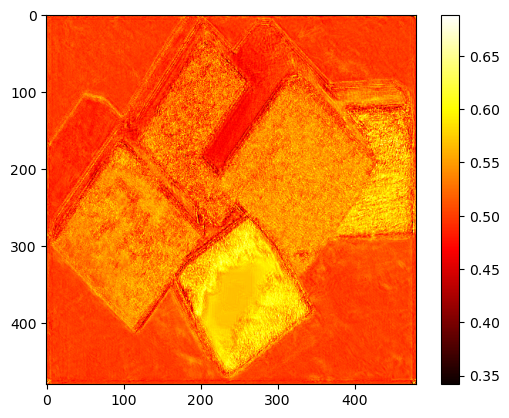

Epoch 11: Train Loss = 0.027804
Epoch 11: Val Loss = 0.025231


Epoch 12/100: 100%|██████████| 16/16 [00:36<00:00,  2.30s/it]


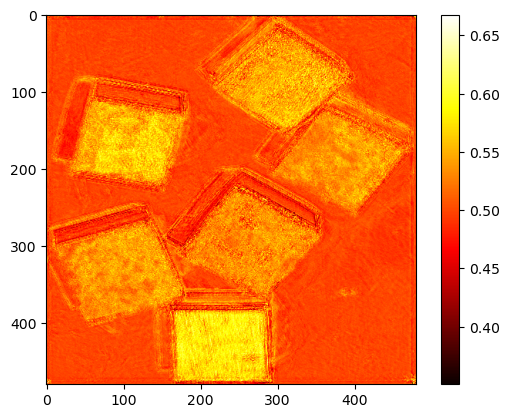

Epoch 12: Train Loss = 0.026909
Epoch 12: Val Loss = 0.024647


Epoch 13/100: 100%|██████████| 16/16 [00:35<00:00,  2.20s/it]


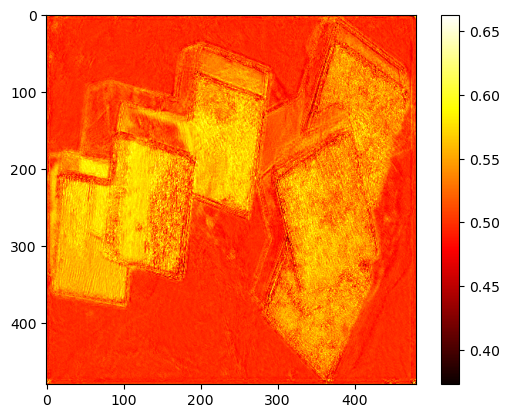

Epoch 13: Train Loss = 0.026275
Epoch 13: Val Loss = 0.024518


Epoch 14/100: 100%|██████████| 16/16 [00:36<00:00,  2.25s/it]


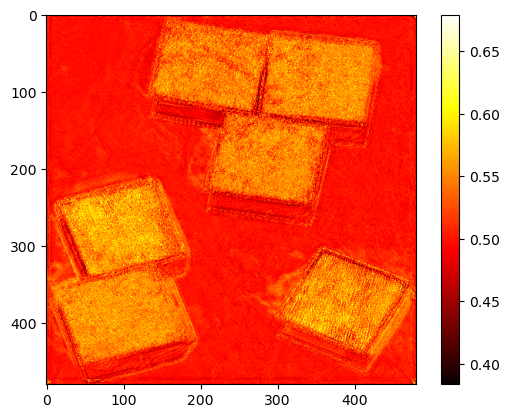

Epoch 14: Train Loss = 0.026065
Epoch 14: Val Loss = 0.023992


Epoch 15/100: 100%|██████████| 16/16 [00:34<00:00,  2.18s/it]


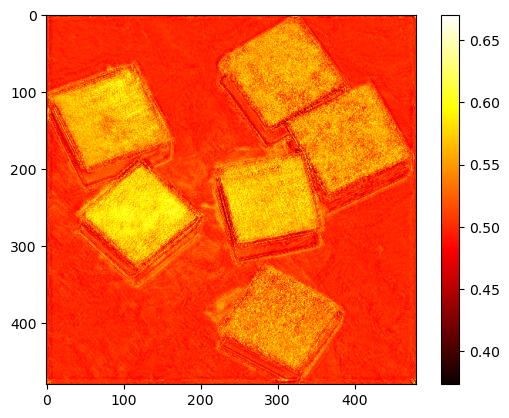

Epoch 15: Train Loss = 0.025400
Epoch 15: Val Loss = 0.023731


Epoch 16/100: 100%|██████████| 16/16 [00:36<00:00,  2.26s/it]


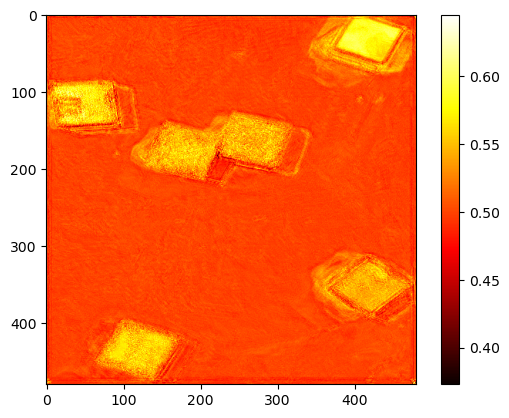

Epoch 16: Train Loss = 0.025457
Epoch 16: Val Loss = 0.023421


Epoch 17/100: 100%|██████████| 16/16 [00:35<00:00,  2.20s/it]


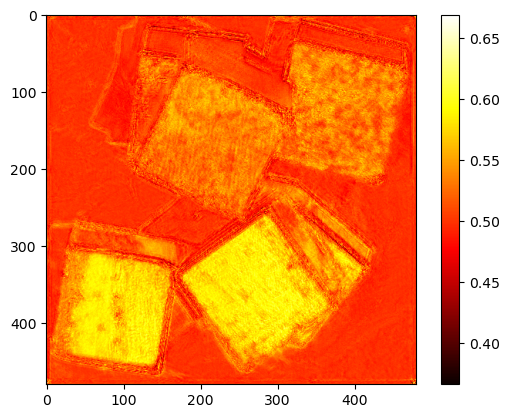

Epoch 17: Train Loss = 0.025100
Epoch 17: Val Loss = 0.023226


Epoch 18/100: 100%|██████████| 16/16 [00:35<00:00,  2.23s/it]


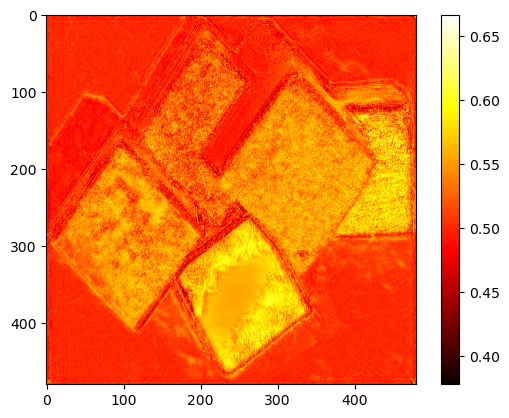

Epoch 18: Train Loss = 0.024819
Epoch 18: Val Loss = 0.023053


Epoch 19/100: 100%|██████████| 16/16 [00:35<00:00,  2.21s/it]


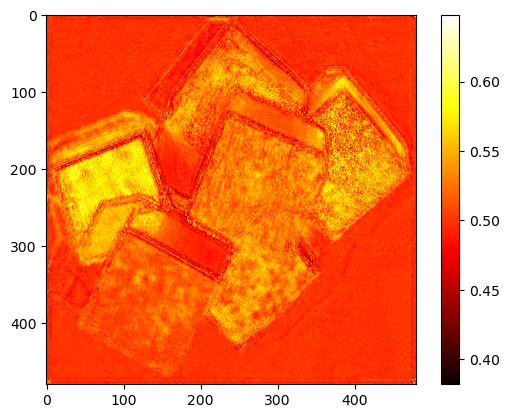

Epoch 19: Train Loss = 0.024672
Epoch 19: Val Loss = 0.022808


Epoch 20/100: 100%|██████████| 16/16 [00:36<00:00,  2.27s/it]


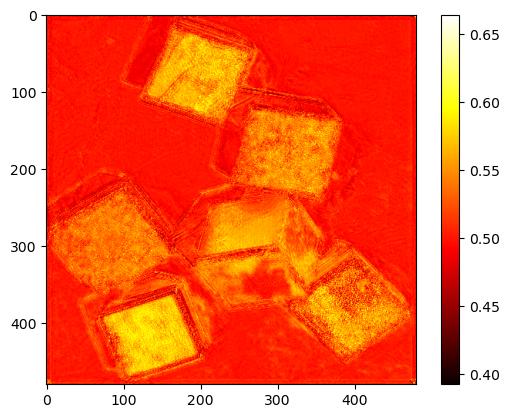

Epoch 20: Train Loss = 0.024314
Epoch 20: Val Loss = 0.022773


Epoch 21/100: 100%|██████████| 16/16 [00:35<00:00,  2.22s/it]


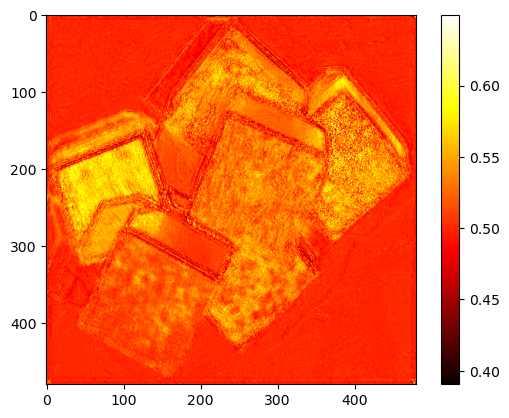

Epoch 21: Train Loss = 0.024242
Epoch 21: Val Loss = 0.022626


Epoch 22/100: 100%|██████████| 16/16 [00:33<00:00,  2.09s/it]


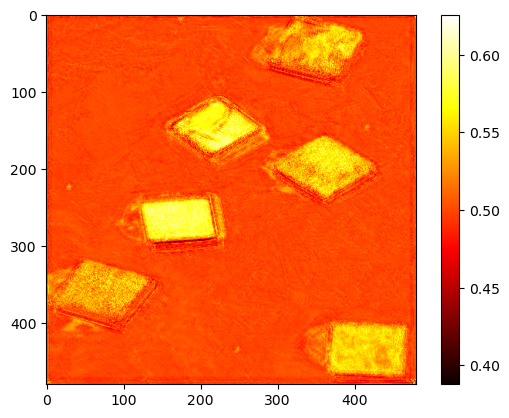

Epoch 22: Train Loss = 0.024143
Epoch 22: Val Loss = 0.022425


Epoch 23/100: 100%|██████████| 16/16 [00:34<00:00,  2.16s/it]


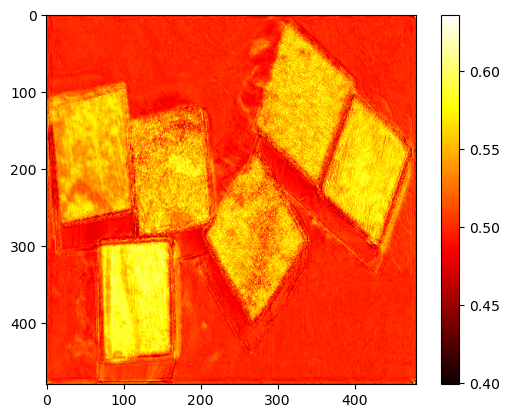

Epoch 23: Train Loss = 0.023924
Epoch 23: Val Loss = 0.022321


Epoch 24/100: 100%|██████████| 16/16 [00:34<00:00,  2.15s/it]


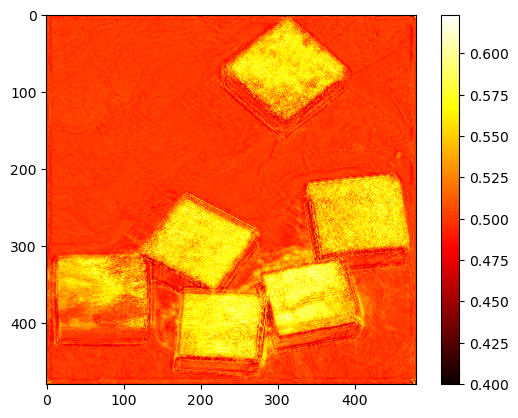

Epoch 24: Train Loss = 0.023696
Epoch 24: Val Loss = 0.022267


Epoch 25/100: 100%|██████████| 16/16 [00:33<00:00,  2.06s/it]


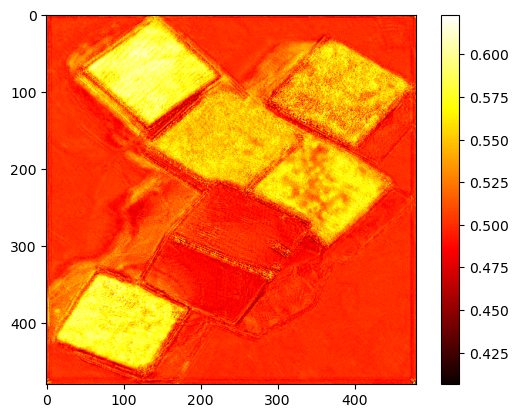

Epoch 25: Train Loss = 0.023669
Epoch 25: Val Loss = 0.022228


Epoch 26/100: 100%|██████████| 16/16 [00:35<00:00,  2.23s/it]


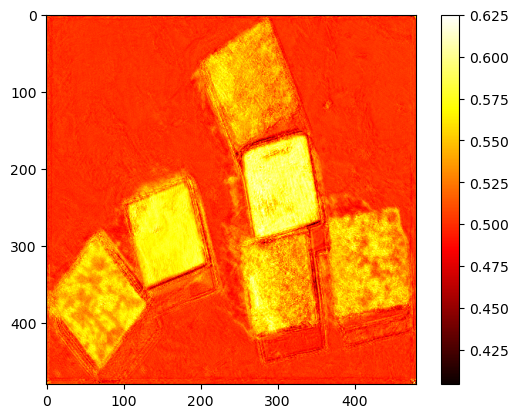

Epoch 26: Train Loss = 0.023566
Epoch 26: Val Loss = 0.022117


Epoch 27/100: 100%|██████████| 16/16 [00:32<00:00,  2.03s/it]


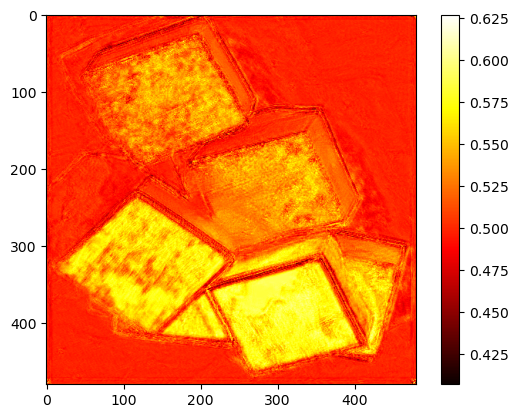

Epoch 27: Train Loss = 0.023318
Epoch 27: Val Loss = 0.022038


Epoch 28/100: 100%|██████████| 16/16 [00:32<00:00,  2.03s/it]


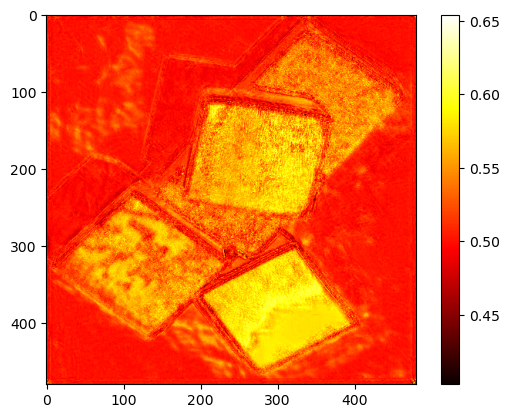

Epoch 28: Train Loss = 0.023207
Epoch 28: Val Loss = 0.022121


Epoch 29/100: 100%|██████████| 16/16 [00:32<00:00,  2.03s/it]


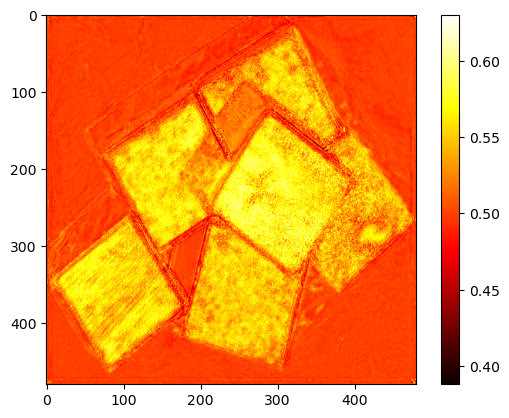

Epoch 29: Train Loss = 0.023248
Epoch 29: Val Loss = 0.021868


Epoch 30/100: 100%|██████████| 16/16 [00:32<00:00,  2.03s/it]


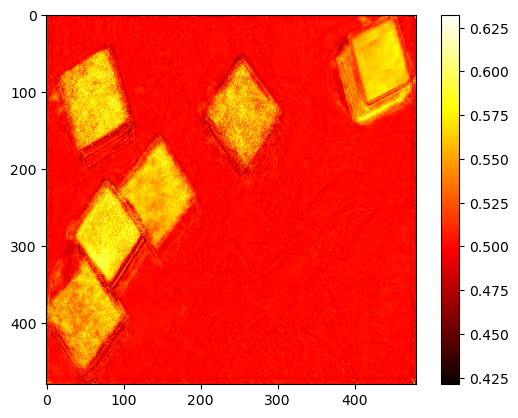

Epoch 30: Train Loss = 0.023210
Epoch 30: Val Loss = 0.021801


Epoch 31/100: 100%|██████████| 16/16 [00:32<00:00,  2.04s/it]


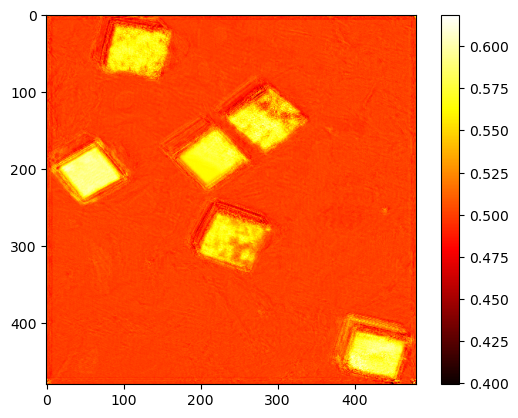

Epoch 31: Train Loss = 0.023010
Epoch 31: Val Loss = 0.021655


Epoch 32/100: 100%|██████████| 16/16 [00:32<00:00,  2.04s/it]


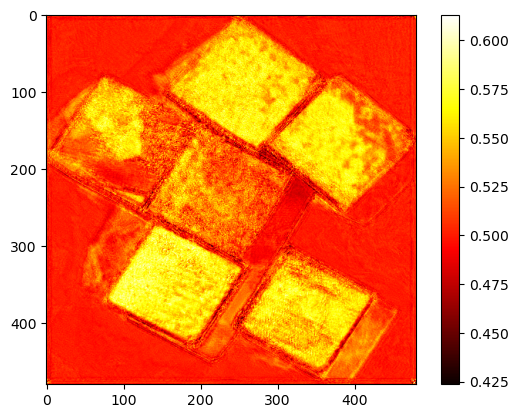

Epoch 32: Train Loss = 0.023020
Epoch 32: Val Loss = 0.021615


Epoch 33/100: 100%|██████████| 16/16 [00:32<00:00,  2.06s/it]


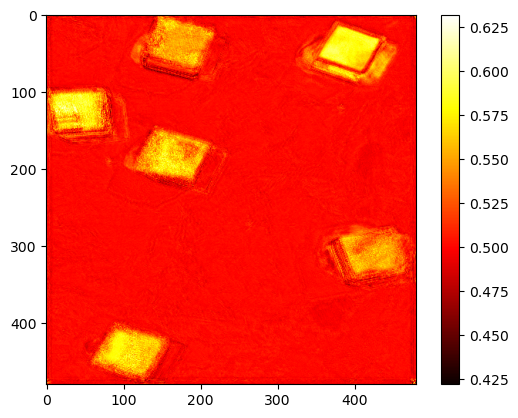

Epoch 33: Train Loss = 0.022849
Epoch 33: Val Loss = 0.021725


Epoch 34/100: 100%|██████████| 16/16 [00:32<00:00,  2.05s/it]


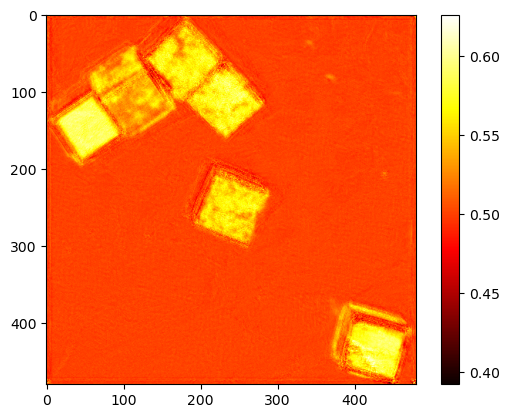

Epoch 34: Train Loss = 0.022802
Epoch 34: Val Loss = 0.021668


Epoch 35/100: 100%|██████████| 16/16 [00:32<00:00,  2.03s/it]


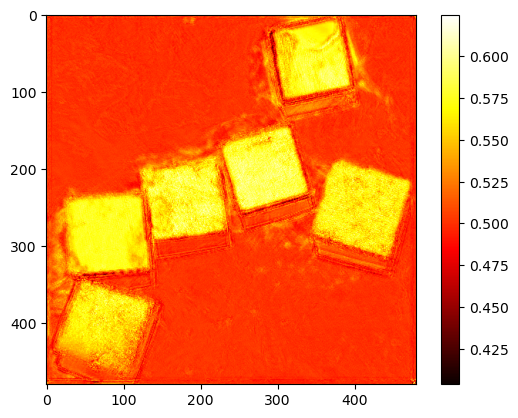

Epoch 35: Train Loss = 0.022744
Epoch 35: Val Loss = 0.021632


Epoch 36/100: 100%|██████████| 16/16 [00:32<00:00,  2.02s/it]


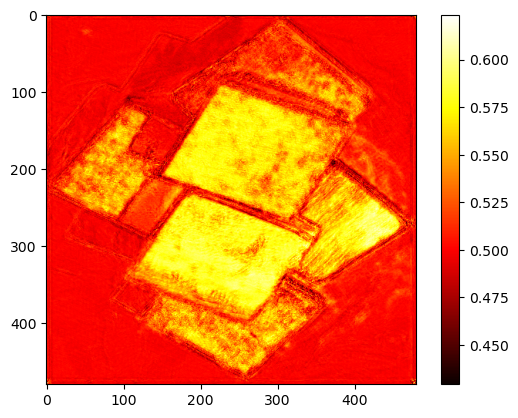

Epoch 36: Train Loss = 0.022623
Epoch 36: Val Loss = 0.021357


Epoch 37/100: 100%|██████████| 16/16 [00:32<00:00,  2.02s/it]


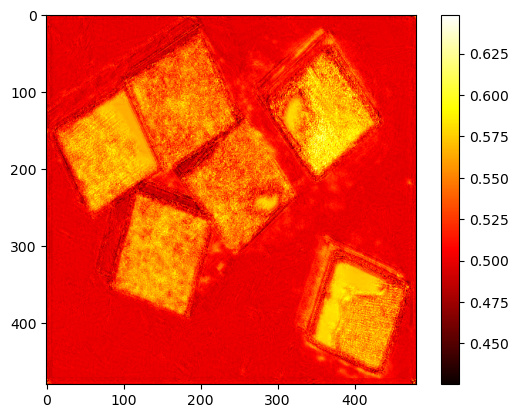

Epoch 37: Train Loss = 0.022517
Epoch 37: Val Loss = 0.021347


Epoch 38/100: 100%|██████████| 16/16 [00:32<00:00,  2.02s/it]


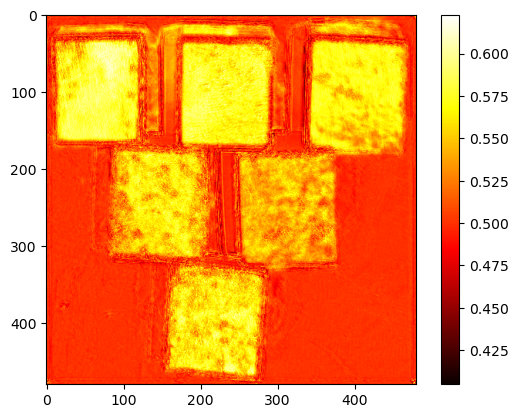

Epoch 38: Train Loss = 0.022711
Epoch 38: Val Loss = 0.021381


Epoch 39/100: 100%|██████████| 16/16 [00:32<00:00,  2.02s/it]


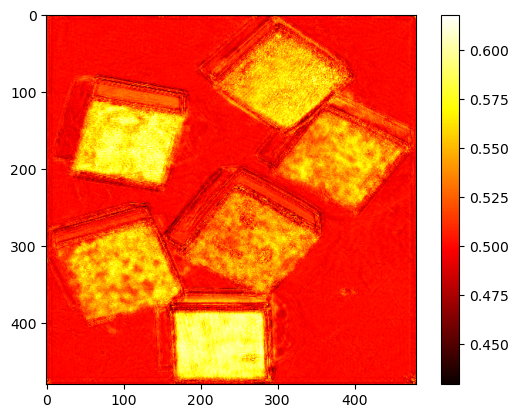

Epoch 39: Train Loss = 0.022367
Epoch 39: Val Loss = 0.021408


Epoch 40/100: 100%|██████████| 16/16 [00:33<00:00,  2.09s/it]


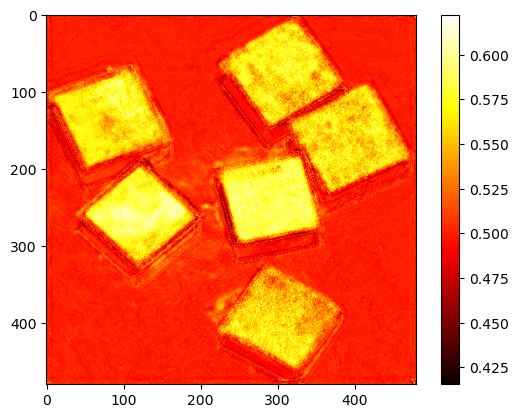

Epoch 40: Train Loss = 0.022455
Epoch 40: Val Loss = 0.021183


Epoch 41/100: 100%|██████████| 16/16 [00:33<00:00,  2.07s/it]


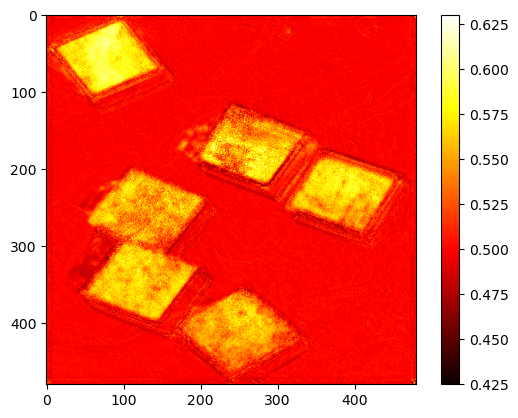

Epoch 41: Train Loss = 0.022359
Epoch 41: Val Loss = 0.021309


Epoch 42/100: 100%|██████████| 16/16 [00:33<00:00,  2.08s/it]


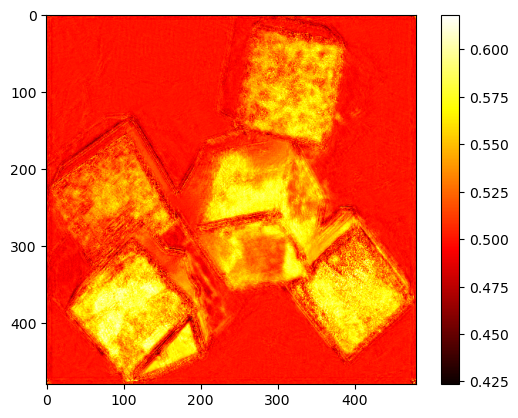

Epoch 42: Train Loss = 0.022158
Epoch 42: Val Loss = 0.021172


Epoch 43/100: 100%|██████████| 16/16 [00:33<00:00,  2.08s/it]


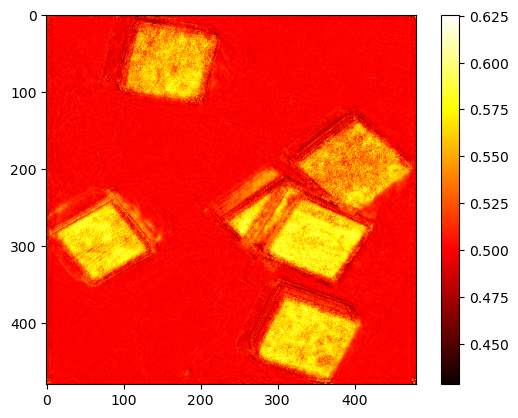

Epoch 43: Train Loss = 0.022164
Epoch 43: Val Loss = 0.021206


Epoch 44/100: 100%|██████████| 16/16 [00:33<00:00,  2.09s/it]


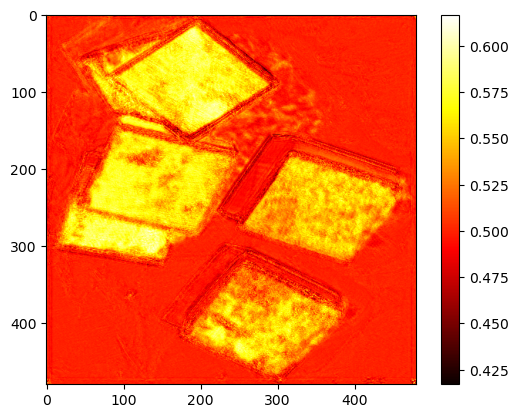

Epoch 44: Train Loss = 0.022217
Epoch 44: Val Loss = 0.021128


Epoch 45/100: 100%|██████████| 16/16 [00:33<00:00,  2.06s/it]


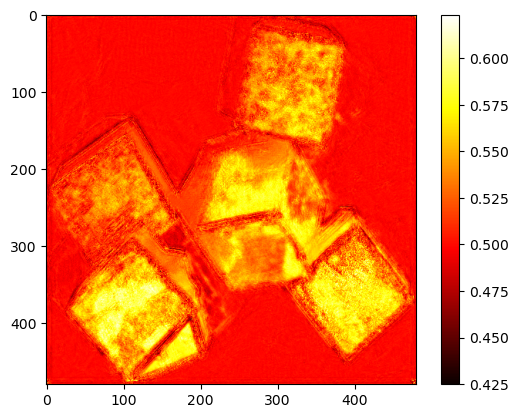

Epoch 45: Train Loss = 0.021915
Epoch 45: Val Loss = 0.021269


Epoch 46/100: 100%|██████████| 16/16 [00:33<00:00,  2.10s/it]


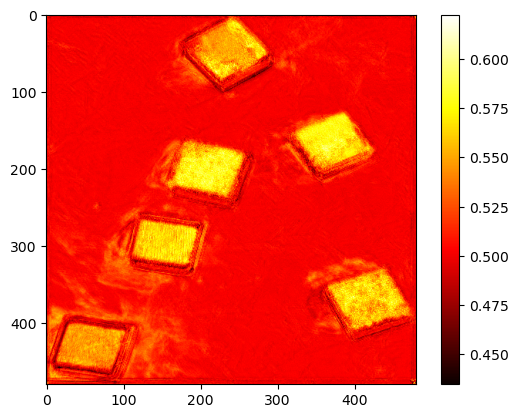

Epoch 46: Train Loss = 0.022129
Epoch 46: Val Loss = 0.021055


Epoch 47/100: 100%|██████████| 16/16 [00:33<00:00,  2.09s/it]


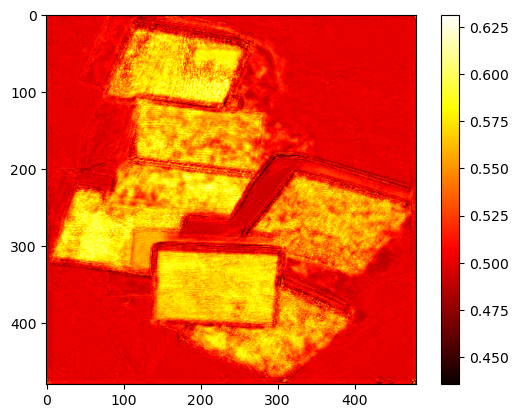

Epoch 47: Train Loss = 0.021956
Epoch 47: Val Loss = 0.021068


Epoch 48/100: 100%|██████████| 16/16 [00:33<00:00,  2.11s/it]


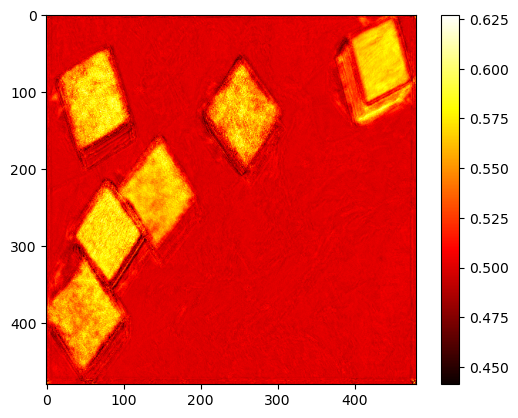

Epoch 48: Train Loss = 0.021839
Epoch 48: Val Loss = 0.020992


Epoch 49/100: 100%|██████████| 16/16 [00:32<00:00,  2.03s/it]


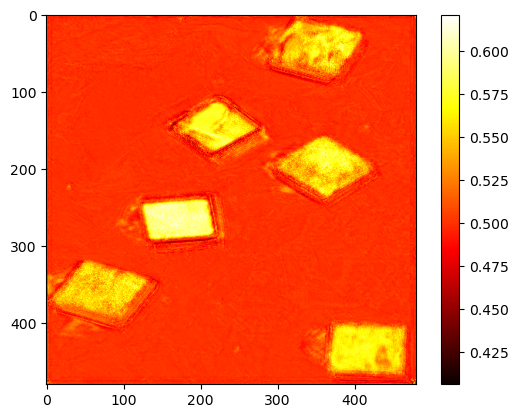

Epoch 49: Train Loss = 0.021734
Epoch 49: Val Loss = 0.021092


Epoch 50/100: 100%|██████████| 16/16 [00:32<00:00,  2.01s/it]


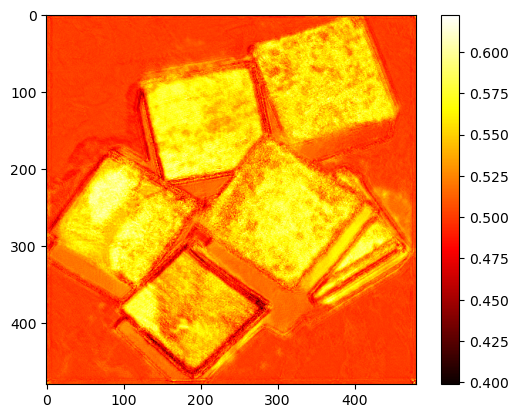

Epoch 50: Train Loss = 0.021803
Epoch 50: Val Loss = 0.021010


Epoch 51/100: 100%|██████████| 16/16 [00:32<00:00,  2.05s/it]


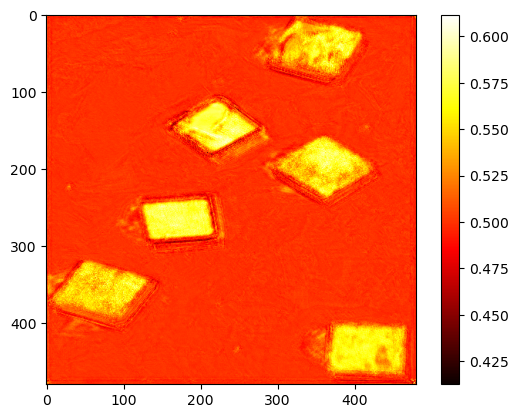

Epoch 51: Train Loss = 0.021600
Epoch 51: Val Loss = 0.020954


Epoch 52/100: 100%|██████████| 16/16 [00:33<00:00,  2.07s/it]


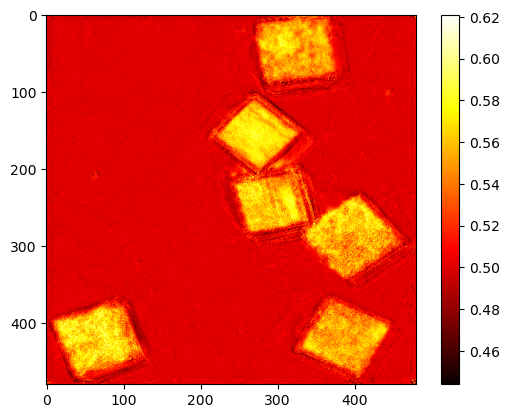

Epoch 52: Train Loss = 0.021736
Epoch 52: Val Loss = 0.020952


Epoch 53/100: 100%|██████████| 16/16 [00:32<00:00,  2.04s/it]


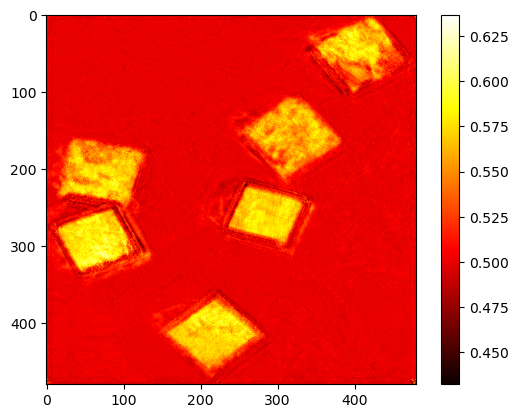

Epoch 53: Train Loss = 0.021813
Epoch 53: Val Loss = 0.020791


Epoch 54/100: 100%|██████████| 16/16 [00:32<00:00,  2.04s/it]


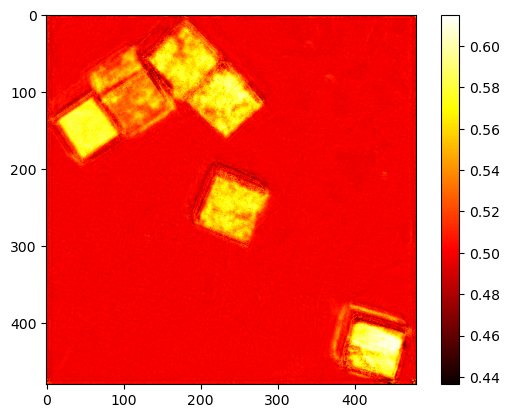

Epoch 54: Train Loss = 0.021663
Epoch 54: Val Loss = 0.020798


Epoch 55/100: 100%|██████████| 16/16 [00:32<00:00,  2.04s/it]


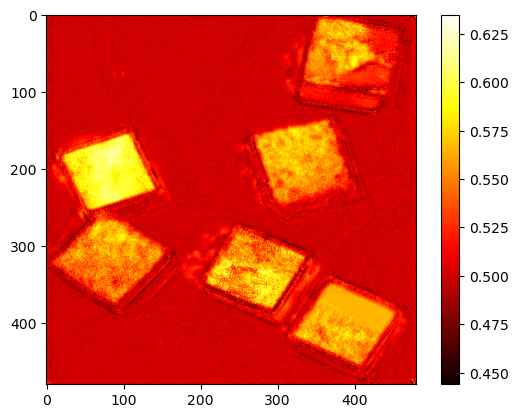

Epoch 55: Train Loss = 0.021685
Epoch 55: Val Loss = 0.020817


Epoch 56/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


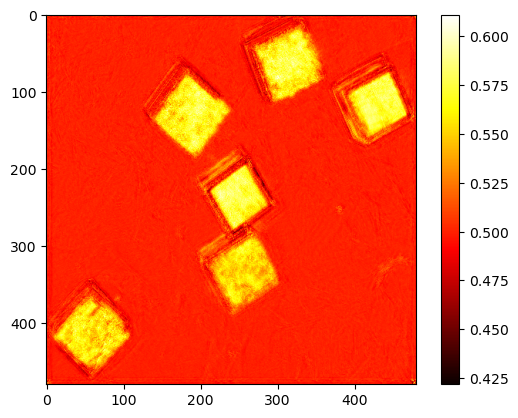

Epoch 56: Train Loss = 0.021586
Epoch 56: Val Loss = 0.020774


Epoch 57/100: 100%|██████████| 16/16 [00:31<00:00,  1.97s/it]


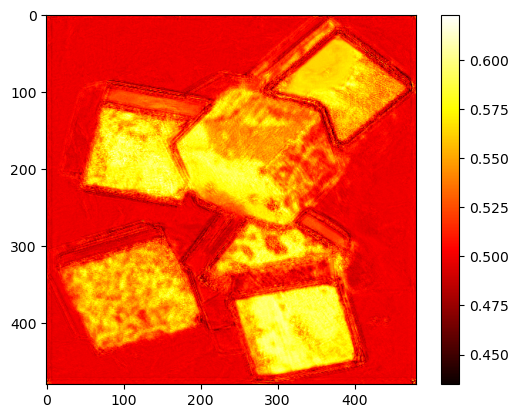

Epoch 57: Train Loss = 0.021587
Epoch 57: Val Loss = 0.020725


Epoch 58/100: 100%|██████████| 16/16 [00:31<00:00,  1.97s/it]


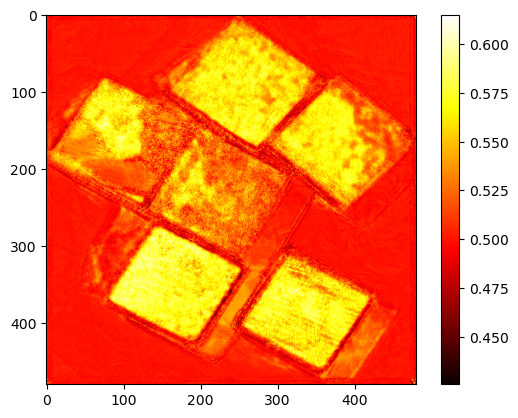

Epoch 58: Train Loss = 0.021445
Epoch 58: Val Loss = 0.020869


Epoch 59/100: 100%|██████████| 16/16 [00:31<00:00,  1.96s/it]


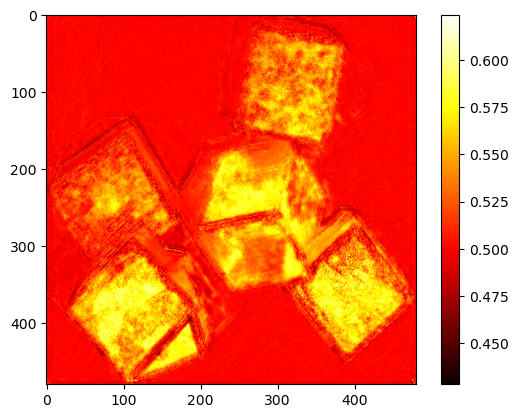

Epoch 59: Train Loss = 0.021393
Epoch 59: Val Loss = 0.020725


Epoch 60/100: 100%|██████████| 16/16 [00:31<00:00,  1.97s/it]


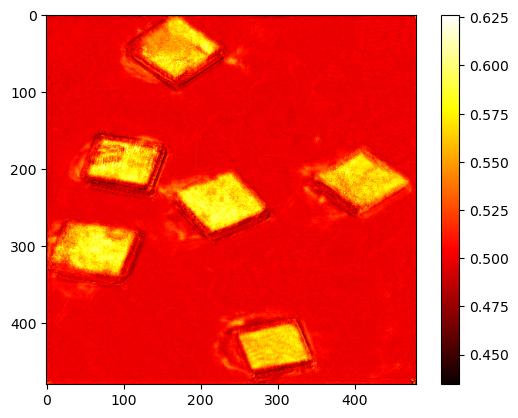

Epoch 60: Train Loss = 0.021381
Epoch 60: Val Loss = 0.020665


Epoch 61/100: 100%|██████████| 16/16 [00:31<00:00,  1.97s/it]


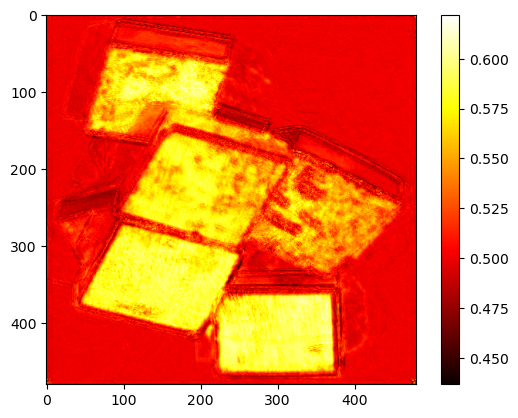

Epoch 61: Train Loss = 0.021384
Epoch 61: Val Loss = 0.020547


Epoch 62/100: 100%|██████████| 16/16 [00:31<00:00,  1.97s/it]


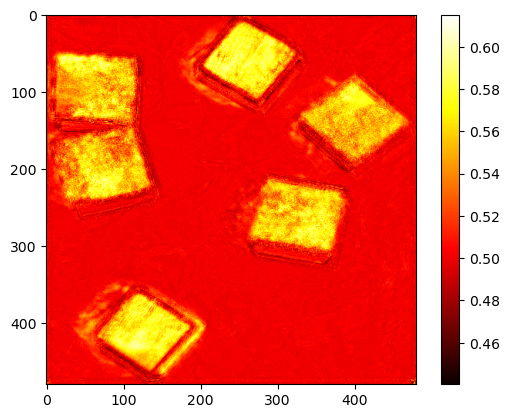

Epoch 62: Train Loss = 0.021276
Epoch 62: Val Loss = 0.020564


Epoch 63/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


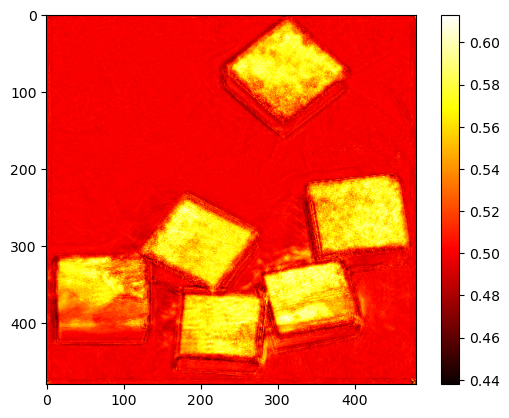

Epoch 63: Train Loss = 0.021198
Epoch 63: Val Loss = 0.020597


Epoch 64/100: 100%|██████████| 16/16 [00:31<00:00,  1.97s/it]


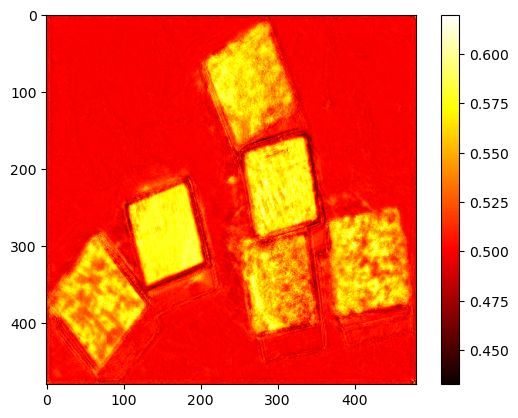

Epoch 64: Train Loss = 0.021138
Epoch 64: Val Loss = 0.020648


Epoch 65/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


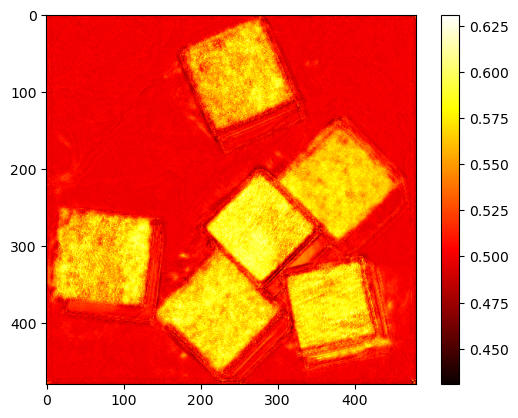

Epoch 65: Train Loss = 0.021124
Epoch 65: Val Loss = 0.020577


Epoch 66/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


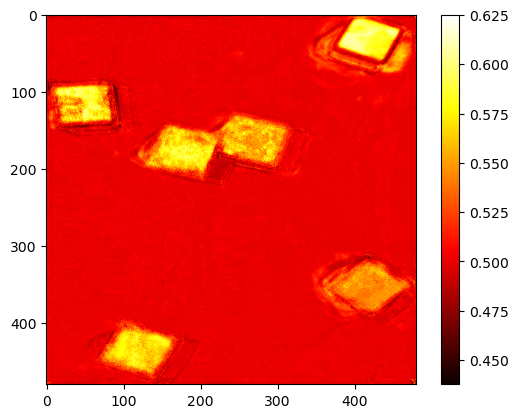

Epoch 66: Train Loss = 0.021060
Epoch 66: Val Loss = 0.020516


Epoch 67/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


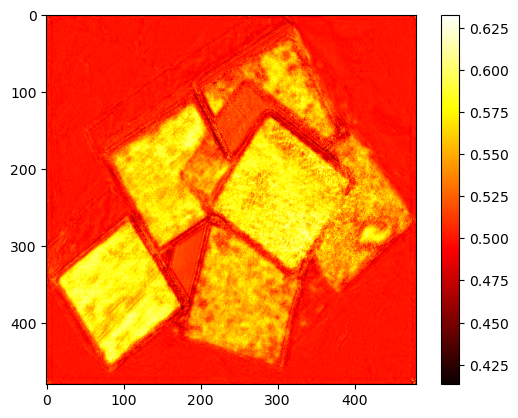

Epoch 67: Train Loss = 0.021072
Epoch 67: Val Loss = 0.020692


Epoch 68/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


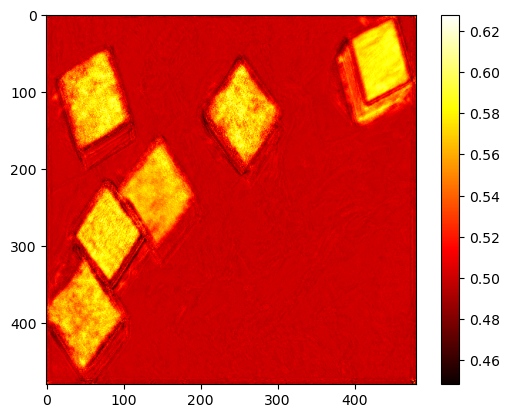

Epoch 68: Train Loss = 0.021038
Epoch 68: Val Loss = 0.020561


Epoch 69/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


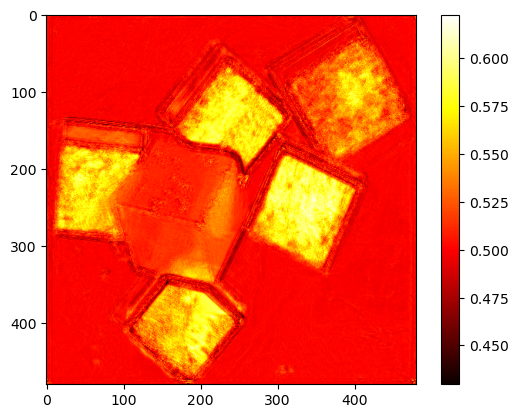

Epoch 69: Train Loss = 0.020994
Epoch 69: Val Loss = 0.020515


Epoch 70/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


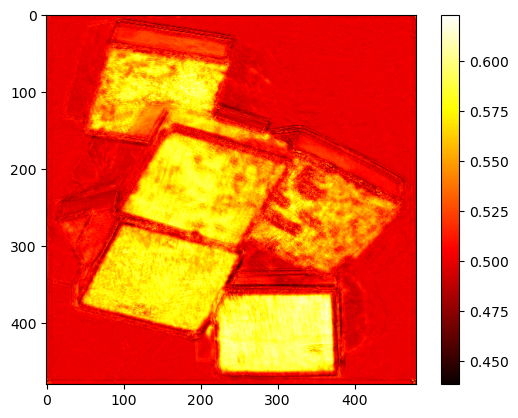

Epoch 70: Train Loss = 0.020995
Epoch 70: Val Loss = 0.020479


Epoch 71/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


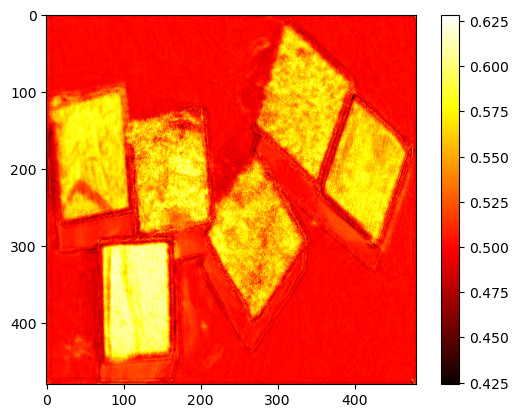

Epoch 71: Train Loss = 0.021158
Epoch 71: Val Loss = 0.020473


Epoch 72/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


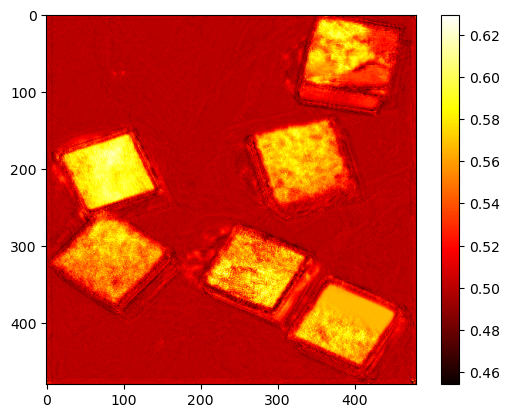

Epoch 72: Train Loss = 0.021168
Epoch 72: Val Loss = 0.020671


Epoch 73/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


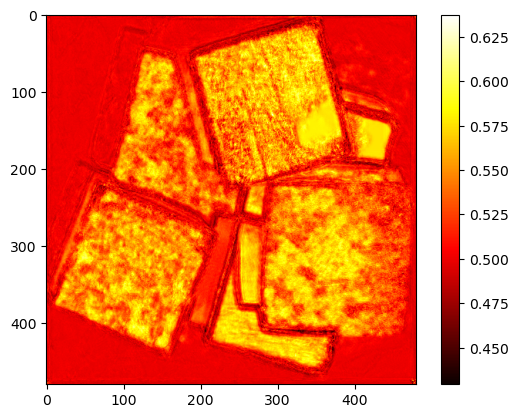

Epoch 73: Train Loss = 0.021005
Epoch 73: Val Loss = 0.020399


Epoch 74/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


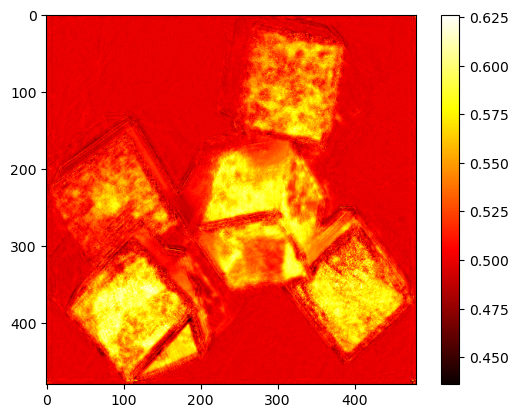

Epoch 74: Train Loss = 0.020944
Epoch 74: Val Loss = 0.020504


Epoch 75/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


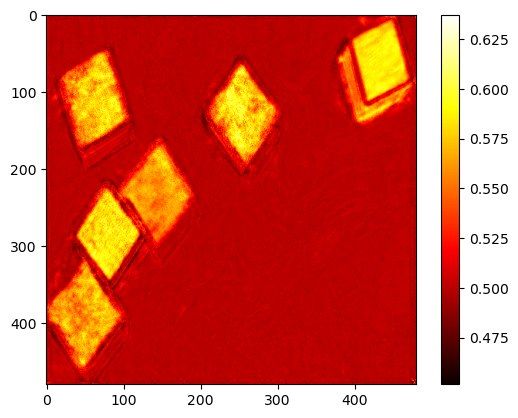

Epoch 75: Train Loss = 0.021017
Epoch 75: Val Loss = 0.020650


Epoch 76/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


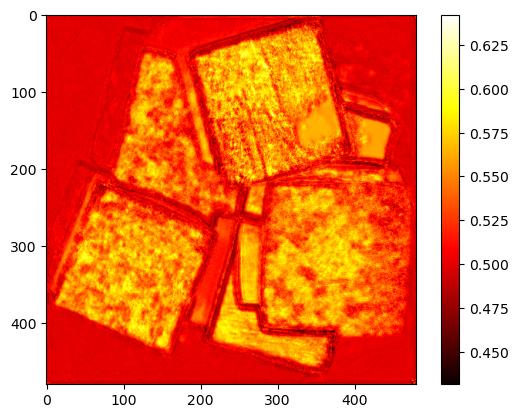

Epoch 76: Train Loss = 0.020882
Epoch 76: Val Loss = 0.020323


Epoch 77/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


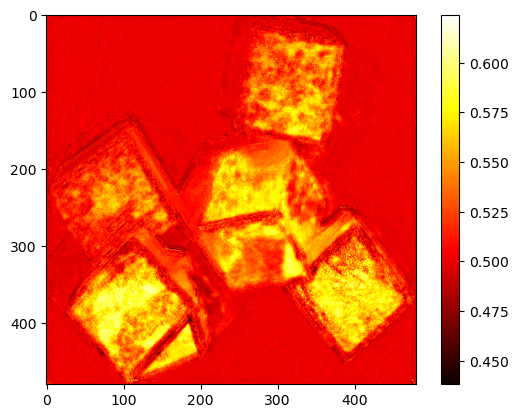

Epoch 77: Train Loss = 0.020868
Epoch 77: Val Loss = 0.020384


Epoch 78/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


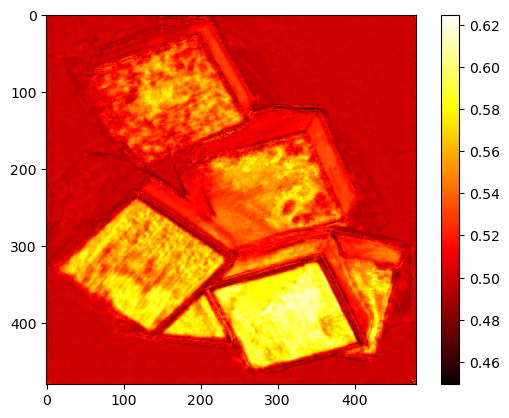

Epoch 78: Train Loss = 0.020761
Epoch 78: Val Loss = 0.020289


Epoch 79/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


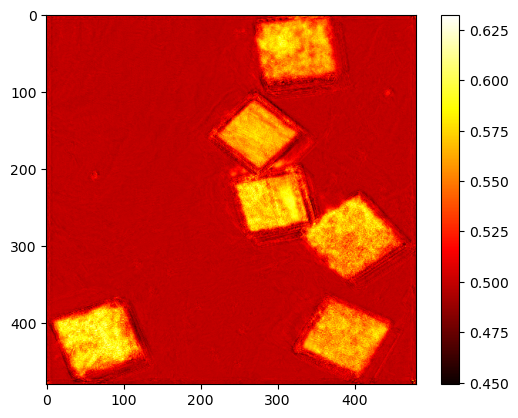

Epoch 79: Train Loss = 0.020626
Epoch 79: Val Loss = 0.020161


Epoch 80/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


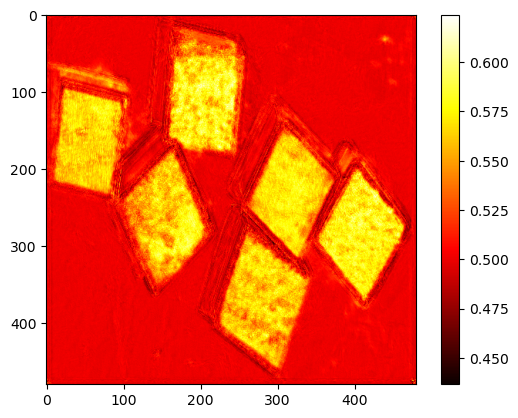

Epoch 80: Train Loss = 0.020651
Epoch 80: Val Loss = 0.020245


Epoch 81/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


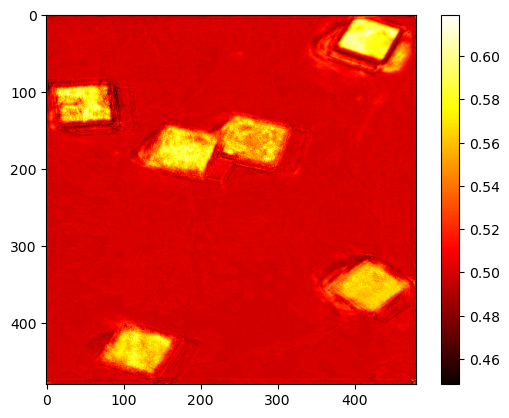

Epoch 81: Train Loss = 0.020945
Epoch 81: Val Loss = 0.020278


Epoch 82/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


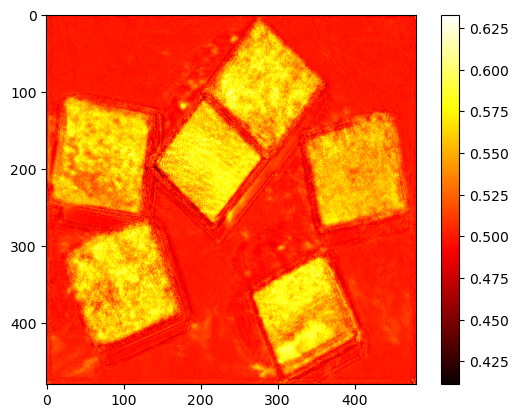

Epoch 82: Train Loss = 0.020697
Epoch 82: Val Loss = 0.020262


Epoch 83/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


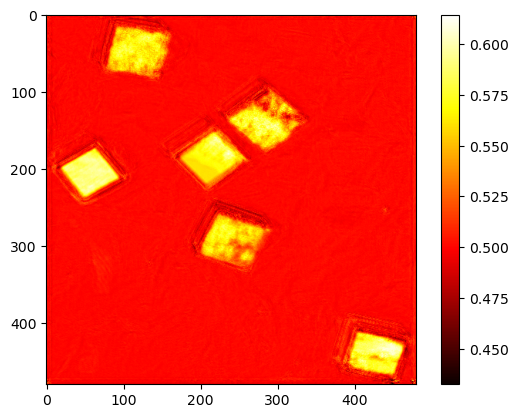

Epoch 83: Train Loss = 0.020735
Epoch 83: Val Loss = 0.019999


Epoch 84/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


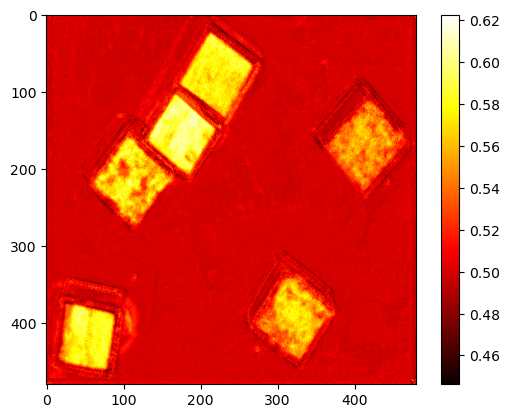

Epoch 84: Train Loss = 0.020636
Epoch 84: Val Loss = 0.020078


Epoch 85/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


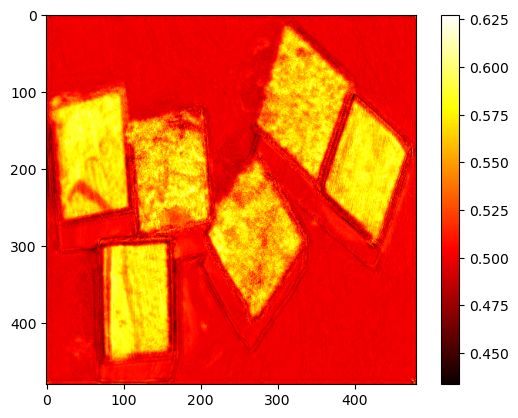

Epoch 85: Train Loss = 0.020552
Epoch 85: Val Loss = 0.020217


Epoch 86/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


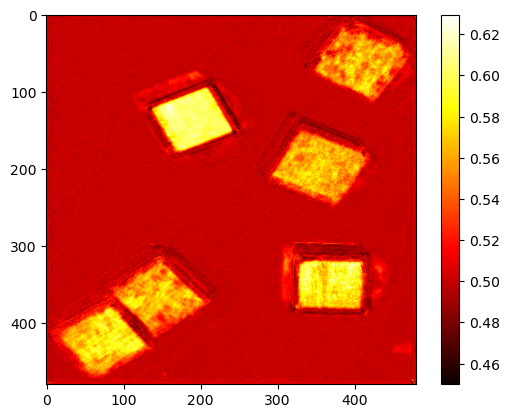

Epoch 86: Train Loss = 0.020879
Epoch 86: Val Loss = 0.020165


Epoch 87/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


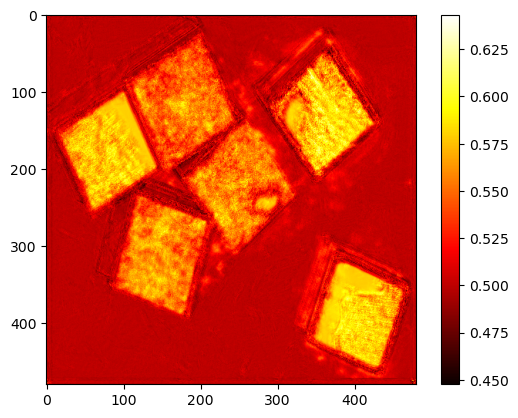

Epoch 87: Train Loss = 0.020554
Epoch 87: Val Loss = 0.020051


Epoch 88/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


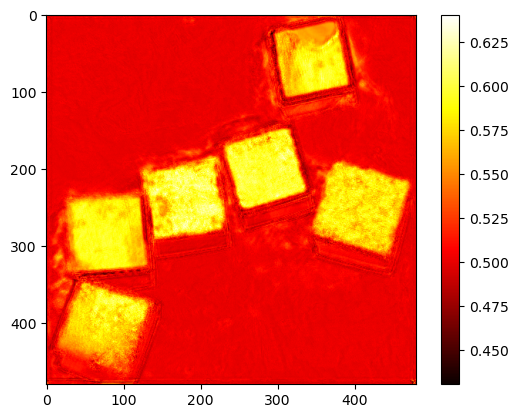

Epoch 88: Train Loss = 0.020436
Epoch 88: Val Loss = 0.020290


Epoch 89/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


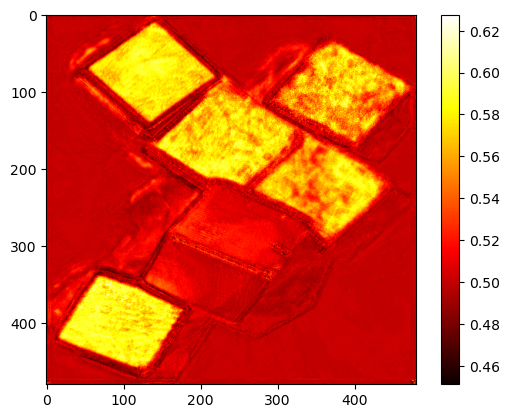

Epoch 89: Train Loss = 0.020466
Epoch 89: Val Loss = 0.020032


Epoch 90/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


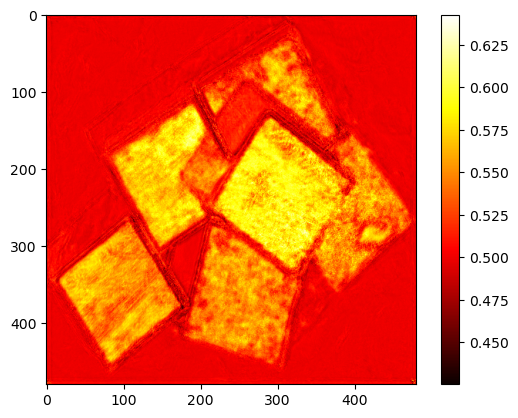

Epoch 90: Train Loss = 0.020612
Epoch 90: Val Loss = 0.019994


Epoch 91/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


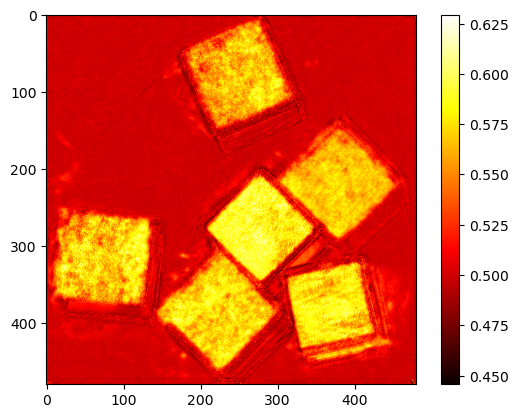

Epoch 91: Train Loss = 0.020544
Epoch 91: Val Loss = 0.020024


Epoch 92/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


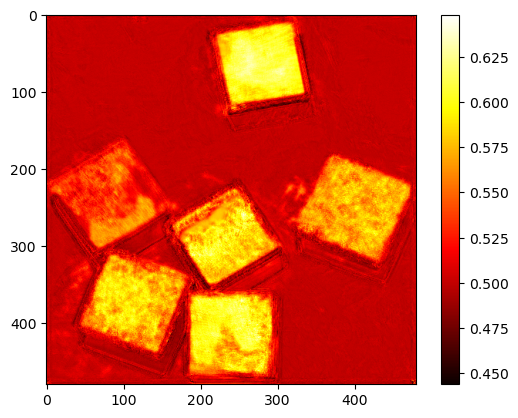

Epoch 92: Train Loss = 0.020592
Epoch 92: Val Loss = 0.020005


Epoch 93/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


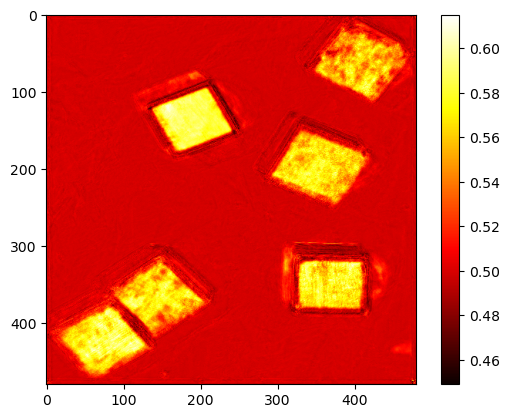

Epoch 93: Train Loss = 0.020432
Epoch 93: Val Loss = 0.019859


Epoch 94/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


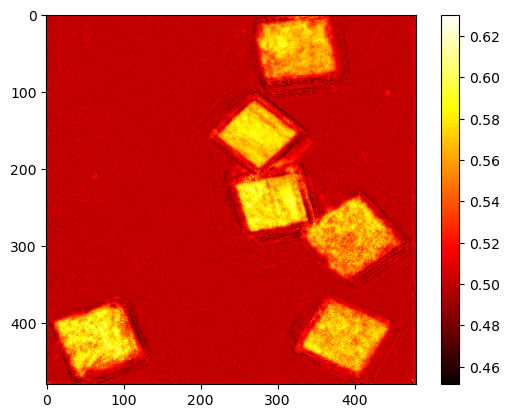

Epoch 94: Train Loss = 0.020434
Epoch 94: Val Loss = 0.019896


Epoch 95/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


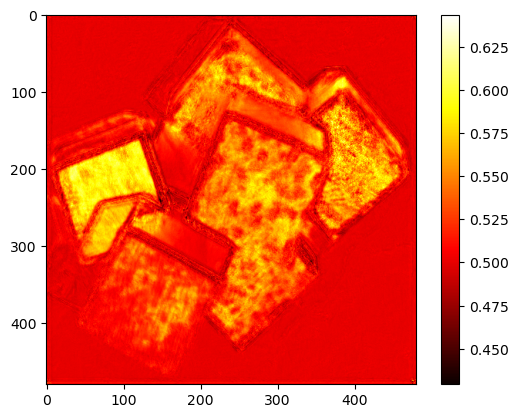

Epoch 95: Train Loss = 0.020368
Epoch 95: Val Loss = 0.020030


Epoch 96/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


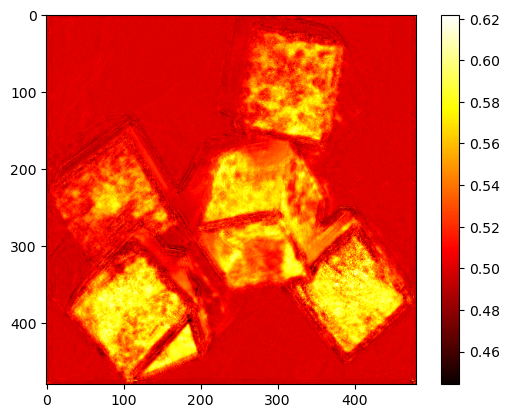

Epoch 96: Train Loss = 0.020440
Epoch 96: Val Loss = 0.019892


Epoch 97/100: 100%|██████████| 16/16 [00:33<00:00,  2.09s/it]


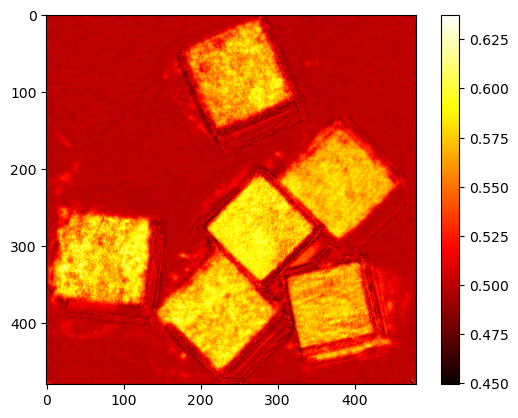

Epoch 97: Train Loss = 0.020240
Epoch 97: Val Loss = 0.019889


Epoch 98/100: 100%|██████████| 16/16 [00:32<00:00,  2.01s/it]


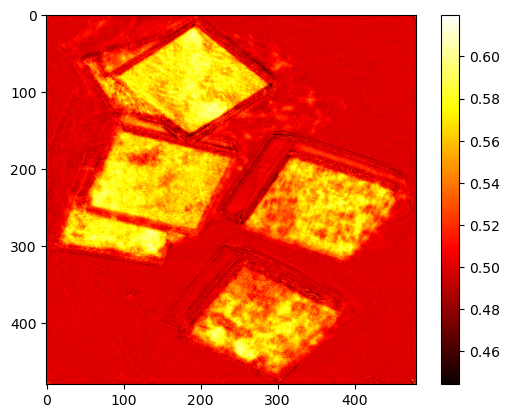

Epoch 98: Train Loss = 0.020444
Epoch 98: Val Loss = 0.019907


Epoch 99/100: 100%|██████████| 16/16 [00:31<00:00,  1.99s/it]


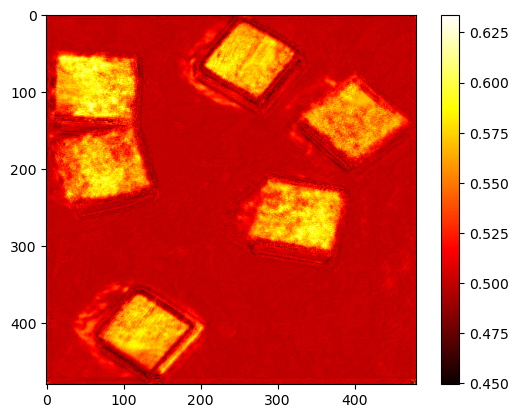

Epoch 99: Train Loss = 0.020215
Epoch 99: Val Loss = 0.019929


Epoch 100/100: 100%|██████████| 16/16 [00:31<00:00,  1.98s/it]


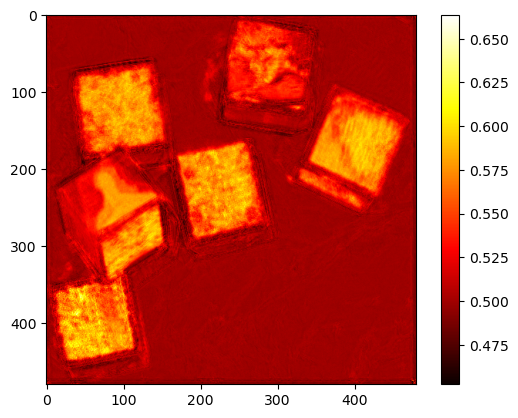

Epoch 100: Train Loss = 0.020210
Epoch 100: Val Loss = 0.019940


In [9]:
scaler = torch.amp.GradScaler(device) # <-- mixed precision scaler

for epoch in range(num_epochs):
    model.train()
    train_loss = 0
    pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}")
    fig, axes = plt.subplots(1, 1)

    # training
    for inputs, targets in pbar:
        inputs = inputs.to(device)
        targets = targets.to(device)

        optimizer.zero_grad()

        with torch.amp.autocast(device): # <-- autocast back in
            outputs = model(inputs) # full forward in FP16/FP32 mix
            loss = criterion(outputs, targets)

        scaler.scale(loss).backward() # <-- scaled backprop
        scaler.step(optimizer)
        scaler.update()

        train_loss += loss.item()

    # heatmap visualization
    model.eval()
    with torch.no_grad():
        for inputs, targets in train_loader: # fresh iterator
            inputs = inputs.to(device)

            with torch.amp.autocast(device): # safe inference AMP
                out = model(inputs[:1])

            out = F.sigmoid(out)
            heatmap = out[0,0].cpu()

            im = axes.imshow(heatmap, cmap='hot')
            fig.colorbar(im, ax=axes)
            plt.show()
            break

    print(f"Epoch {epoch+1}: Train Loss = {train_loss / len(train_loader):.6f}")

    # validation
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for val_inputs, val_targets in test_loader:
            val_inputs = val_inputs.to(device)
            val_targets = val_targets.to(device)

            with torch.amp.autocast(device):
                val_outputs = model(val_inputs)
                val_loss += criterion(val_outputs, val_targets).item()

    print(f"Epoch {epoch+1}: Val Loss = {val_loss / len(test_loader):.6f}")

In [ ]:
torch.save(model.state_dict(), "models/metal_surface_rgb_onehot_bce.pth") 

In [ ]:
model.load_state_dict(torch.load("models/metal_surface_rgb_onehot_bce.pth"))
model.eval()

C:\Users\agile\AppData\Local\Temp\ipykernel_22876\3412676040.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("models/metal_edge_rgb_oneh

MetalEdge(
  (c1_1): CNNBlock(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (c1_2): CNNBlock(
    (net): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (c1_3): CNNBlock(
    (net): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), st

# Testing

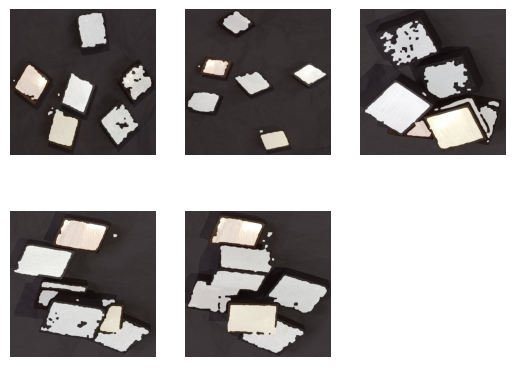

In [8]:
scaler = torch.amp.GradScaler(device)

def test_model(images, model):
    model.eval()
    B = images.size(0)

    fig, axes = plt.subplots(B // 2, B - (B // 2))
    axes = axes.flatten()

    images = images.to(device)
    outputs = model(images)
    
    for ax in axes:
        ax.axis("off")
    
    for i in range(B):
        with torch.amp.autocast(device):
            prob = torch.sigmoid(outputs[i])
            label = prob.view(1, 480, 480).detach().cpu()
            label = F.avg_pool2d(label, kernel_size=5, stride=1, padding=2)
            label = label.reshape(480, 480)
            label = (label >= 0.35)
            label = label.numpy()
            label = binary_opening(label, structure=np.ones((5,5)))
            label = binary_closing(label, structure=np.ones((5,5)))
            image = images[i].detach().cpu().numpy() # (3, H, W)
            
            if image.max() <= 1.0:
                image = (image * 255).astype(np.uint8)

            image = np.transpose(image, (1, 2, 0)) # (H, W, 3)
            
            axes[i].imshow(image)
            axes[i].imshow(label, cmap="hot", alpha=0.7)
        
    plt.show()

images, _ = next(iter(test_loader))
test_model(images, model)